# NEW YORK CITY TAXI FARES (NYCTF)

## Project imports, folders and variables

### General imports

In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from math import *

#pyplot
%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

#dealing with folder paths
import os
import sys

#serialisation and compression
import pickle

#refreshing modules imports
from importlib import reload

#display images
import IPython
from IPython.display import Image

# from francois import babyfoot_cheat_engine

Populating the interactive namespace from numpy and matplotlib


/opt/conda/envs/env35/lib/python3.5/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['fabs', 'isfinite', 'isinf', 'expm1', 'gcd', 'sin', 'fmod', 'ceil', 'sinh', 'isnan', 'hypot', 'tan', 'exp', 'cos', 'frexp', 'log1p', 'e', 'cosh', 'inf', 'modf', 'floor', 'log', 'sqrt', 'nan', 'log2', 'log10', 'gamma', 'trunc', 'isclose', 'copysign', 'pi', 'tanh', 'radians', 'ldexp', 'degrees']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


### Folder paths

In [2]:
projectDir = os.path.join(os.getcwd(), os.pardir, os.pardir)
#notebook is in "NYCTF/notebooks/exploratory" or "NYCTF/notebooks/reports": this actually links to NYCTF

srcDir = os.path.join(projectDir, 'src')
sys.path.append(srcDir) #adds src to search path for modules

dataDir = os.path.join(projectDir, 'data')
pickleDir = os.path.join(dataDir, 'processed/pickle')

### Modules imports

In [3]:
import NYCTF_data_preparation as dp; reload(dp);
import NYCTF_geo as geo; reload(geo);

### Variables

In [4]:
b_usePickleFiles = True
#True should you want to use the data stored using pickle
#False should you want to (re)generate the data from scratch

b_dataPrepared = True
#True if the loaded data are already prepared
#False if the loaded data are raw

readcsvParseDates = False
#only matters if usePickleFiles is set to False
#["pickup_datetime"] should you want to parse dates when reading the csv file
#False shoud you want to do it later (manually)

minmaxCoordinates = [40, 42, -75, -71] #[latitudeMin, latitudeMax, longitudeMin, longitudeMax]
#needs some more exploration and thinking. will change for min max in test set

colTypes = {'fare_amount': 'float32', #tried float16 but then you cannot calculate the mean and std
         'pickup_longitude': 'float32',
         'pickup_latitude': 'float32',
         'dropoff_longitude': 'float32',
         'dropoff_latitude': 'float32',
         'passenger_count': 'uint8'}

distUnit = 'km'
rEarth = 6371 #radius of the Earth in dist_unit

b_mathsDemoOn = True

## Data loading & preparation

### Get number of lines in the csv files (if loading from csv)

In [5]:
%%time

#choose method among 'unixwc' and 'readlines'. 'readlines' (resp. 'unixwc') faster for short (resp. long) files
method = 'readlines'

if not b_usePickleFiles:
    trainRowCount = dp.row_count(os.path.join(dataDir, 'raw/train.csv'), method)
    testRowCount = dp.row_count(os.path.join(dataDir, 'raw/test.csv'), method)
    print('Number of lines in train file: ' + str(trainRowCount))
    print('Number of lines in test file: ' + str(testRowCount))
else:
    print('Training and test datasets will not come from .csv files.')

Training and test datasets will not come from .csv files.
CPU times: user 45 µs, sys: 49 µs, total: 94 µs
Wall time: 101 µs


### Load the data (from csv or pickle files)

In [6]:
%%time
if b_usePickleFiles:
    if b_dataPrepared:
        with open(os.path.join(dataDir, 'processed/pickle/trainPrep.pickle'), 'rb') as f:
            dfTrainPrep = pickle.load(f)
        with open(os.path.join(dataDir, 'processed/pickle/testPrep.pickle'), 'rb') as f:
            dfTestPrep = pickle.load(f)
    else:
        with open(os.path.join(dataDir, 'processed/pickle/train.pickle'), 'rb') as f:
            dfTrain = pickle.load(f)
        with open(os.path.join(dataDir, 'processed/pickle/test.pickle'), 'rb') as f:
            dfTest = pickle.load(f)
else:
    dfTrain = pd.read_csv(os.path.join(dataDir, 'raw/train.csv'), parse_dates=readcsvParseDates)
    dfTest = pd.read_csv(os.path.join(dataDir, 'raw/test.csv'), parse_dates=readcsvParseDates)
    with open(os.path.join(dataDir, 'processed/pickle/train.pickle'), 'wb') as f:
        pickle.dump(dfTrain, f)
    with open(os.path.join(dataDir, 'processed/pickle/test.pickle'), 'wb') as f:
        pickle.dump(dfTest, f)

CPU times: user 7.23 s, sys: 5.36 s, total: 12.6 s
Wall time: 13.9 s


### Data preparation

In [7]:
%%time
if not b_dataPrepared:
    dfTestPrep = dp.prepare_data(dfTest, 'test', colTypes, readcsvParseDates==False, True, pickleDir, 'testPrep.pickle')
    print(dfTestPrep.info())
else:
    print('Data already prepared.')

Data already prepared.
CPU times: user 72 µs, sys: 0 ns, total: 72 µs
Wall time: 54.4 µs


In [8]:
%%time
if not b_dataPrepared:
    dfTrainPrep = dp.prepare_data(dfTrain, 'Train', colTypes, readcsvParseDates==False, True, pickleDir, 'trainPrep.pickle')
    print(dfTrainPrep.info())
else:
    print('Data already prepared.')

Data already prepared.
CPU times: user 180 µs, sys: 0 ns, total: 180 µs
Wall time: 116 µs


## Geo (cleaning + first ideas)

### Cleaning

In [9]:
%%time
#Remove outlying coordinates
dfTrainPrep = geo.removeOutlyingCoordinates(dfTrainPrep, minmaxCoordinates)

CPU times: user 2.52 s, sys: 1.85 s, total: 4.37 s
Wall time: 4.37 s


### Adding a 'distance' feature

First method is flying distance.
Second method consists of rotating the map of Manhattan then using the 1-distance.
Third method consists of using Google Maps (or similar) - the itinerary may however not be the one the taxi driver actually took.

In [10]:
dfTrainPrep_sample = dfTrainPrep.head(100)

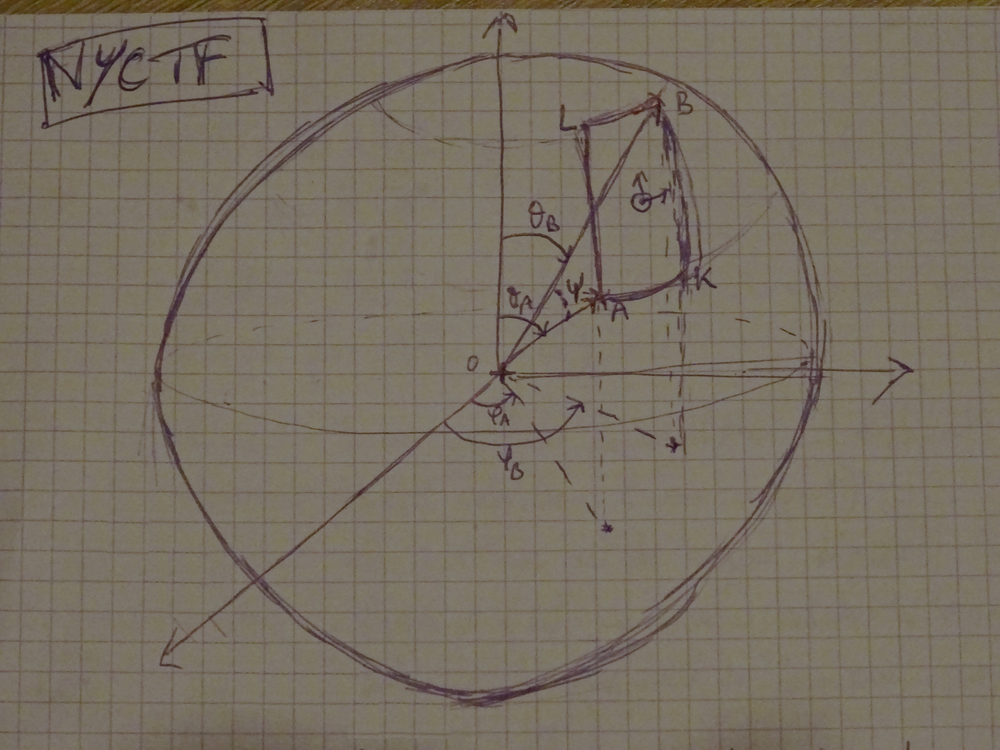

In [11]:
if b_mathsDemoOn:
    display(Image(os.path.join(dataDir, 'processed/images/sphere.jpg')))

#### Flying distance

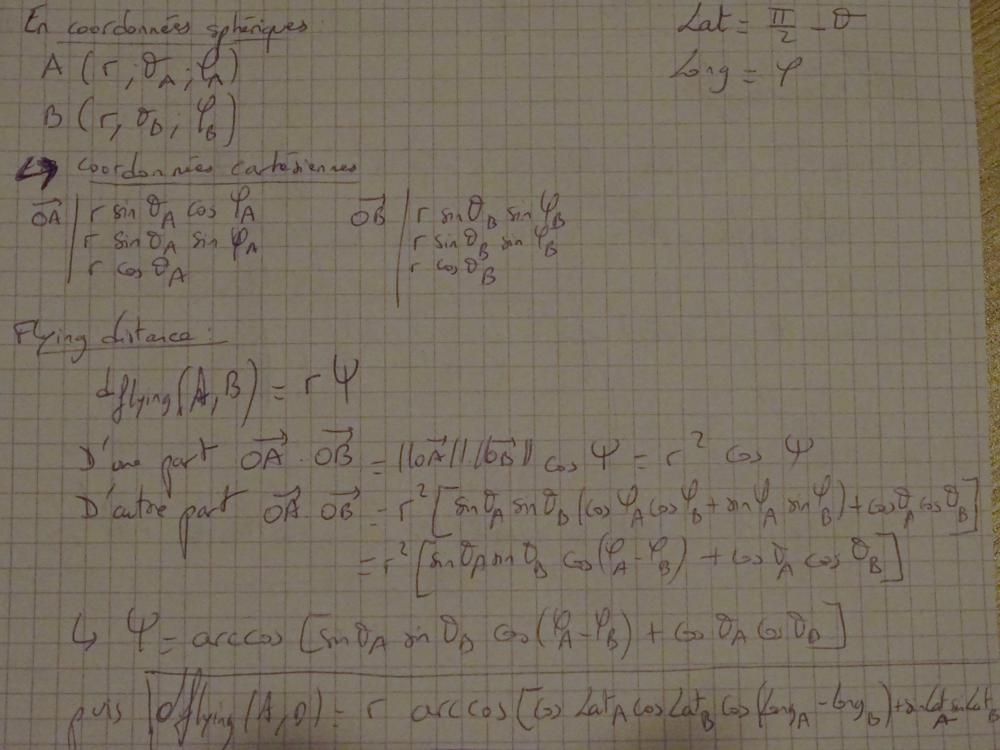

In [12]:
if b_mathsDemoOn:
    display(Image(os.path.join(dataDir, 'processed/images/flying_distance.JPG')))

In [13]:
%%time
dfTrainPrep_sample = geo.add_flying_distance(dfTrainPrep_sample, 'deg', rEarth, distUnit)

CPU times: user 14 ms, sys: 5.58 ms, total: 19.6 ms
Wall time: 17.8 ms


#### L1-distance

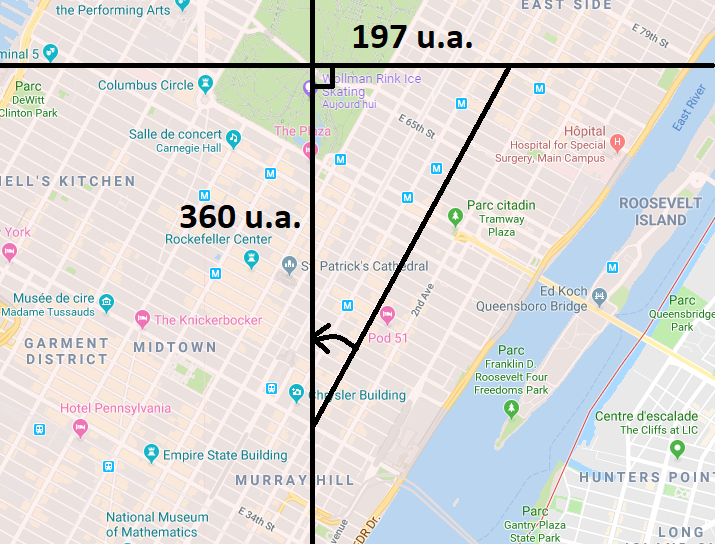

Angle: 0.5007080588399464 rad = 28.68845853971702°.


In [14]:
#Calculating the angle that the Manhattan street grid is rotated from the north-south axis
#https://www.nytimes.com/2006/07/02/nyregion/thecity/02grid.html quotes 29°. let's check this.
display(Image(os.path.join(dataDir, 'processed/images/Manhattan_street_angle.png')))

lMan = 197
hMan = 360
angMan = atan(lMan/hMan) #(rad)
print('Angle: ' + str(angMan) +' rad = ' + str(angMan*180/pi) + '°.')

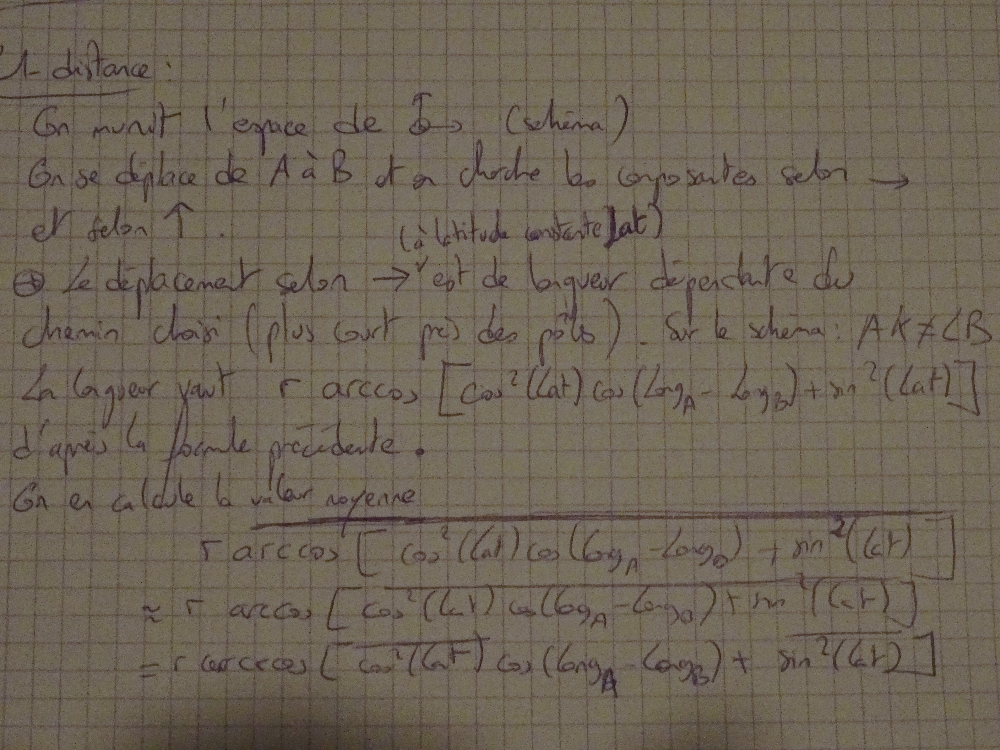

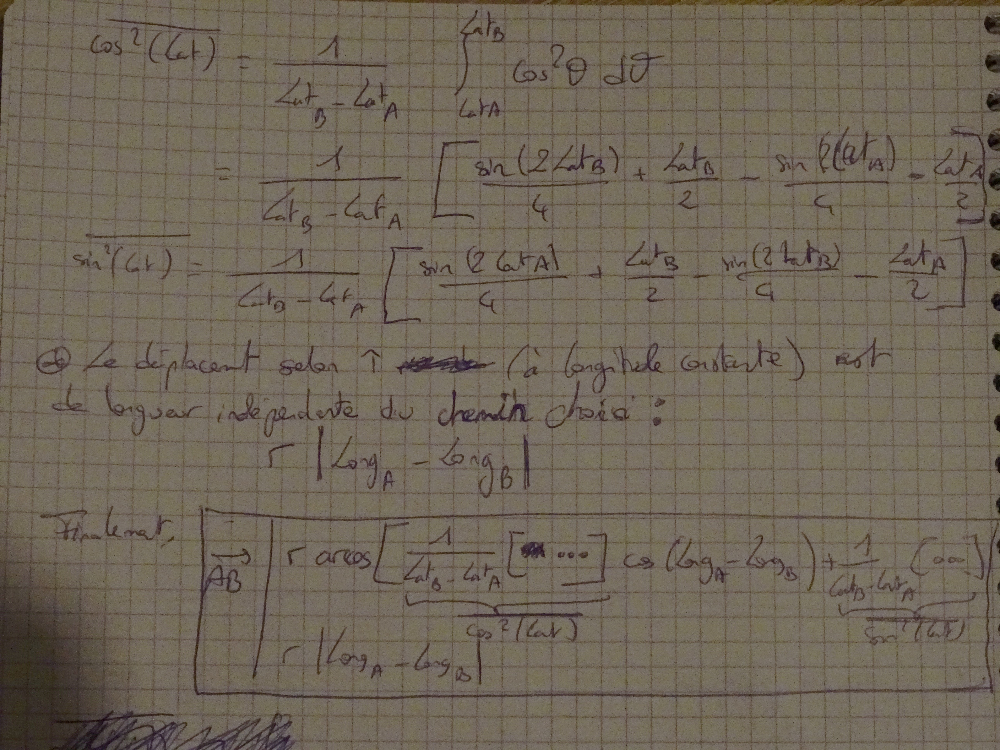

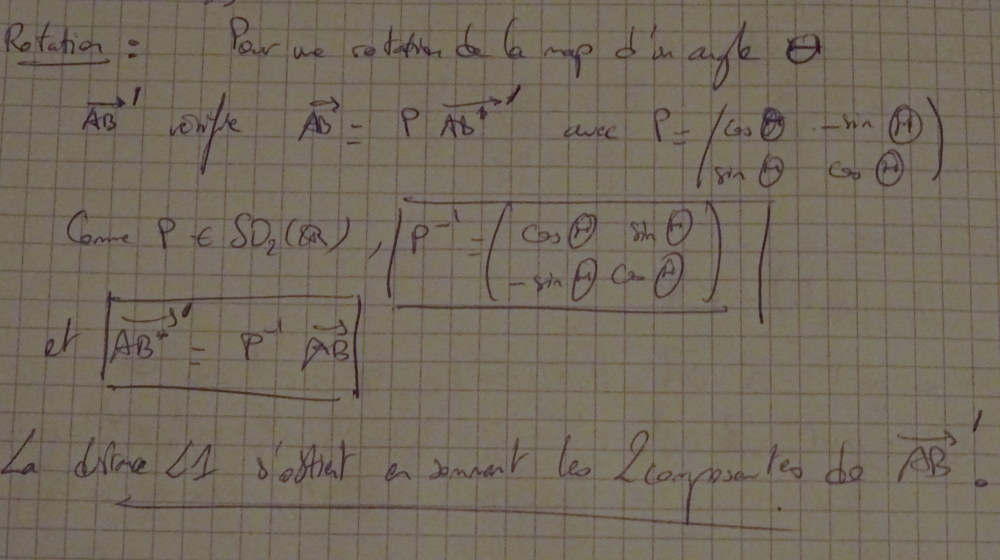

In [15]:
if b_mathsDemoOn:
    display(Image(os.path.join(dataDir, 'processed/images/L1_distance_1.JPG')))
    display(Image(os.path.join(dataDir, 'processed/images/L1_distance_2.JPG')))
    display(Image(os.path.join(dataDir, 'processed/images/L1_distance_3.JPG')))

In [16]:
%%time
dfTrainPrep_sample = geo.add_L1_distance(dfTrainPrep_sample, 'deg', rEarth, distUnit, angMan) #plane_rot_angle in rad please

CPU times: user 14.3 ms, sys: 5.76 ms, total: 20 ms
Wall time: 18.4 ms


In [17]:
print(dfTrainPrep_sample.head(20))

                              key  fare_amount           pickup_datetime  \
0     2009-06-15 17:26:21.0000001          4.5 2009-06-15 17:26:00+00:00   
1     2010-01-05 16:52:16.0000002         16.9 2010-01-05 16:52:00+00:00   
2    2011-08-18 00:35:00.00000049          5.7 2011-08-18 00:35:00+00:00   
3     2012-04-21 04:30:42.0000001          7.7 2012-04-21 04:30:00+00:00   
4   2010-03-09 07:51:00.000000135          5.3 2010-03-09 07:51:00+00:00   
5     2011-01-06 09:50:45.0000002         12.1 2011-01-06 09:50:00+00:00   
6     2012-11-20 20:35:00.0000001          7.5 2012-11-20 20:35:00+00:00   
7    2012-01-04 17:22:00.00000081         16.5 2012-01-04 17:22:00+00:00   
8   2012-12-03 13:10:00.000000125          9.0 2012-12-03 13:10:00+00:00   
9    2009-09-02 01:11:00.00000083          8.9 2009-09-02 01:11:00+00:00   
10    2012-04-08 07:30:50.0000002          5.3 2012-04-08 07:30:00+00:00   
12    2009-11-06 01:04:03.0000002          4.1 2009-11-06 01:04:00+00:00   
13  2013-07-

### Geographical clusters?

In [18]:
#1 cluster would be, for example, the JFK airport, or a "neighbourhood" in NYC (maybe not the official ones, can be customised/calculated zones)

## Time (first ideas)

In [19]:
#Time clusters / geo-time clusters / time-related features?

#weekday/WE, night, rushhour, before/after 201X when they changed the fares...: all those that impact the fare directly through surchages
#these should not be geo-dependent

#some other time-related paramaters/clusters might be geo-dependent (id est impact the traffic situation)

#---
#Estimate the duration of the trip?

#---
#Open data...?

#Weather data, traffic data...?
